In [81]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split

In [82]:
# from ucimlrepo import fetch_ucirepo 
  
# # fetch dataset 
# bank_marketing = fetch_ucirepo(id=222) 
  
# # data (as pandas dataframes) 
# X = bank_marketing.data.features 
# y = bank_marketing.data.targets 
  
# # metadata 
# print(bank_marketing.metadata) 
  
# # variable information 
# print(bank_marketing.variables) 


In [83]:
import requests

url = 'https://archive.ics.uci.edu/static/public/222/data.csv'

request = requests.get(url)
with open("../data/raw/bank-full.csv", 'wb') as f:
        f.write(request.content)

In [84]:
# bank_additional = pd.read_csv('../data/bank-additional/bank-additional-full.csv', sep=';')
# bank = pd.read_csv('../data/bank/bank-full.csv', sep=';')
bank = pd.read_csv('../data/raw/bank-full.csv', sep=',')

In [85]:
# bank_additional

In [86]:
bank.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day_of_week', 'month', 'duration', 'campaign',
       'pdays', 'previous', 'poutcome', 'y'],
      dtype='object')

In [87]:
bank.shape

(45211, 17)

In [88]:
bank.head()

,age,job,marital,education,default,balance,housing,loan,contact,day_of_week,month,duration,campaign,pdays,previous,poutcome,y
0,58,management,married,tertiary,no,2143,yes,no,NaN,5,may,261,1,-1,0,NaN,no
1,44,technician,single,secondary,no,29,yes,no,NaN,5,may,151,1,-1,0,NaN,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,NaN,5,may,76,1,-1,0,NaN,no
3,47,blue-collar,married,NaN,no,1506,yes,no,NaN,5,may,92,1,-1,0,NaN,no
4,33,NaN,single,NaN,no,1,no,no,NaN,5,may,198,1,-1,0,NaN,no


In [89]:
bank.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 17 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   age          45211 non-null  int64 
 1   job          44923 non-null  object
 2   marital      45211 non-null  object
 3   education    43354 non-null  object
 4   default      45211 non-null  object
 5   balance      45211 non-null  int64 
 6   housing      45211 non-null  object
 7   loan         45211 non-null  object
 8   contact      32191 non-null  object
 9   day_of_week  45211 non-null  int64 
 10  month        45211 non-null  object
 11  duration     45211 non-null  int64 
 12  campaign     45211 non-null  int64 
 13  pdays        45211 non-null  int64 
 14  previous     45211 non-null  int64 
 15  poutcome     8252 non-null   object
 16  y            45211 non-null  object
dtypes: int64(7), object(10)
memory usage: 5.9+ MB


In [90]:
bank.y.value_counts()/len(bank)

y
no    0.883
yes   0.117
Name: count, dtype: float64

Pay attention that the target is **class-imbalanced**

# global config

In [142]:
pd.set_option('display.max_columns', None)
# pd.set_option('display.max_rows', None)
pd.options.display.float_format = '{:.3f}'.format
RANDOM_STATE = 522

# train test split

In [92]:
bank_train, bank_test = train_test_split(bank
                                        , test_size=0.2
                                        , random_state=random_state
                                        , stratify=bank.y
                                        )

In [93]:
bank_train.y.value_counts()/len(bank_train)

y
no    0.883
yes   0.117
Name: count, dtype: float64

Via stratified split, we managed to keep the distribtuion of the label in the original dataset.

# EDA

In [94]:
for i in list(bank_train.columns):
    print(f"{i:<10}->  {bank_train[i].nunique():<5} unique values")

age       ->  77    unique values
job       ->  11    unique values
marital   ->  3     unique values
education ->  3     unique values
default   ->  2     unique values
balance   ->  6601  unique values
housing   ->  2     unique values
loan      ->  2     unique values
contact   ->  2     unique values
day_of_week->  31    unique values
month     ->  12    unique values
duration  ->  1506  unique values
campaign  ->  47    unique values
pdays     ->  536   unique values
previous  ->  40    unique values
poutcome  ->  3     unique values
y         ->  2     unique values


In [95]:
bank_int = list(bank_train.select_dtypes(include = ['int64']).columns)
bank_str = list(bank_train.select_dtypes(include = ['object']).columns)
# bank_str.remove("y")
bank_categorical = bank_str+['day']

In [96]:
bank_categorical

['job',
 'marital',
 'education',
 'default',
 'housing',
 'loan',
 'contact',
 'month',
 'poutcome',
 'y',
 'day']

# Altair

In [97]:
bank.education.value_counts()

education
secondary    23202
tertiary     13301
primary       6851
Name: count, dtype: int64

In [98]:
bank.education.isna().sum()

1857

In [99]:
import altair as alt

alt.data_transformers.disable_max_rows()

charts = []

for i, var in enumerate(bank_categorical):
    if i == 9:  
        break

    num_rows = len(bank_train[var].unique())

    chart = alt.Chart(bank_train).mark_bar(stroke=None).encode(
        x=alt.X('count()', title='Count'),
        y=alt.Y('y:N', title=None),
        color=alt.Color('y:N', scale=alt.Scale(range=['#3C6682', '#45A778'])),
        row=alt.Row(f'{var}:N')
    ).properties(
        width=200,
        height=200 / num_rows,
        title=f'Grouped Bar Plot for {var}',
        spacing=0
    )

    charts.append(chart)

final_chart = alt.concat(*charts, columns=3).configure_axis(grid=False).configure_header(
    labelAngle=0,
    labelAlign='left'
)

final_chart


alt.ConcatChart(...)

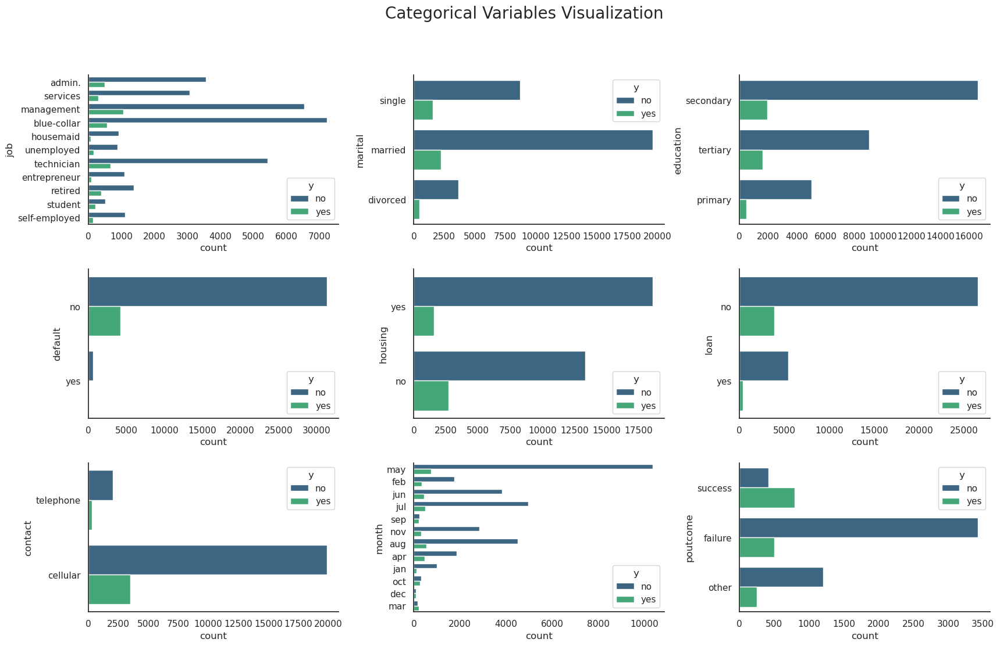

In [100]:
fig, axes = plt.subplots(3, 3, figsize=(20, 12))
plt.suptitle('Categorical Variables Visualization', fontsize=20)
plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.3, hspace=0.3)
for i, ax in enumerate(axes.ravel()):
    if i > 9:
        ax.set_visible(False)
        continue
    sns.set_theme(style="white")
    sns.countplot(y = bank_str[i], data = bank_train, hue='y', ax = ax, palette="viridis")    
    sns.despine()
    
plt.show()

# Altair

In [101]:
bank_continuous = bank_train[bank_int]

charts = []

for i, column in enumerate(bank_continuous.columns):
    hist_chart = alt.Chart(bank_train).mark_bar(opacity=0.7, color='steelblue').encode(
        x=alt.X(f'{column}:Q', bin=alt.Bin(maxbins=50), title=column),
        y=alt.Y('count():Q', stack=None, title='Count'),
    )

    kde_chart = alt.Chart(bank_train).transform_density(
        column,
        as_=[column, 'density'],
    ).mark_line(color='red').encode(
        x=alt.X(f'{column}:Q', title=column),
        y=alt.Y('density:Q', title='Density'),
    )

    chart = alt.layer(hist_chart, kde_chart).resolve_scale(y='independent').properties(
        width=200,
        height=150,
        title=f'{column}'
    )

    charts.append(chart)

final_chart = alt.concat(*charts, columns=3).configure_axis(grid=False)

final_chart

alt.ConcatChart(...)

Continuous Variables Visualization


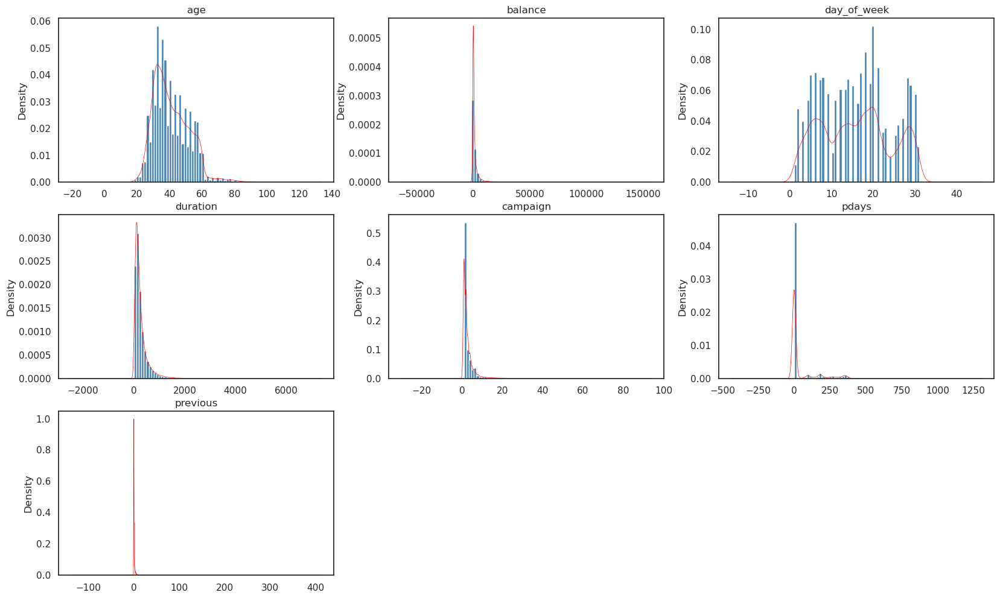

In [102]:
print("Continuous Variables Visualization")
fig, axes = plt.subplots(nrows = 3,ncols = 3,figsize = (20,12))
for i, item in enumerate(bank_int):
    if i < 3:
#         ax = sns.displot(bank[item], bins=100, hist=True, kde=True)
        ax = bank_train[item].plot(kind = 'hist', ax=axes[0,i], bins=50, density=True, color='steelblue')
        ax = bank_train[item].plot(kind = 'kde', ax=axes[0,i], color = 'red', linewidth=0.5)
    elif i >=3 and i < 6:
        ax = bank_train[item].plot(kind = 'hist', ax=axes[1,i-3], bins=50, density=True, color='steelblue')
        ax = bank_train[item].plot(kind = 'kde', ax=axes[1,i-3], color = 'red', linewidth=0.5)
    elif i < 9:
        ax = bank_train[item].plot(kind = 'hist', ax=axes[2,i-6], bins=100, density=True, color='steelblue')
        ax = bank_train[item].plot(kind = 'kde', ax=axes[2,i-6], color = 'red', linewidth=0.5)
        
    ax.set_title(item)
plt.delaxes(axes[2, 1])
plt.delaxes(axes[2, 2])

# Altair

In [103]:
bank_log = ['balance', 'duration', 'campaign', 'pdays', 'previous']
charts = []

for i, column in enumerate(bank_log):
    hist_chart = alt.Chart(bank_train).mark_bar(opacity=0.7, color='steelblue').encode(
        x=alt.X(f'{column}:Q', bin=alt.Bin(maxbins=50), title=column),
        y=alt.Y('count():Q', stack=None, title='Count'),
    )

    kde_chart = alt.Chart(bank_train).transform_density(
        column,
        as_=[column, 'density'],
    ).mark_line(color='red').encode(
        x=alt.X(f'{column}:Q', title=column),
        y=alt.Y('density:Q', title='Density'),
    )

    chart = alt.layer(hist_chart, kde_chart).resolve_scale(y='independent').properties(
        width=200,
        height=150,
        title=f'{column}'
    )

    charts.append(chart)

final_chart = alt.concat(*charts, columns=3).configure_axis(grid=False)

final_chart

alt.ConcatChart(...)

# preprocessing

In [104]:
bank.head()

,age,job,marital,education,default,balance,housing,loan,contact,day_of_week,month,duration,campaign,pdays,previous,poutcome,y
0,58,management,married,tertiary,no,2143,yes,no,NaN,5,may,261,1,-1,0,NaN,no
1,44,technician,single,secondary,no,29,yes,no,NaN,5,may,151,1,-1,0,NaN,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,NaN,5,may,76,1,-1,0,NaN,no
3,47,blue-collar,married,NaN,no,1506,yes,no,NaN,5,may,92,1,-1,0,NaN,no
4,33,NaN,single,NaN,no,1,no,no,NaN,5,may,198,1,-1,0,NaN,no


In [105]:
for i in ['y','loan','housing','default']:
    bank[i] = bank[i].map({'yes':1,'no':0})

In [106]:
bank.head()

,age,job,marital,education,default,balance,housing,loan,contact,day_of_week,month,duration,campaign,pdays,previous,poutcome,y
0,58,management,married,tertiary,0,2143,1,0,NaN,5,may,261,1,-1,0,NaN,0
1,44,technician,single,secondary,0,29,1,0,NaN,5,may,151,1,-1,0,NaN,0
2,33,entrepreneur,married,secondary,0,2,1,1,NaN,5,may,76,1,-1,0,NaN,0
3,47,blue-collar,married,NaN,0,1506,1,0,NaN,5,may,92,1,-1,0,NaN,0
4,33,NaN,single,NaN,0,1,0,0,NaN,5,may,198,1,-1,0,NaN,0


In [107]:
bank.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 17 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   age          45211 non-null  int64 
 1   job          44923 non-null  object
 2   marital      45211 non-null  object
 3   education    43354 non-null  object
 4   default      45211 non-null  int64 
 5   balance      45211 non-null  int64 
 6   housing      45211 non-null  int64 
 7   loan         45211 non-null  int64 
 8   contact      32191 non-null  object
 9   day_of_week  45211 non-null  int64 
 10  month        45211 non-null  object
 11  duration     45211 non-null  int64 
 12  campaign     45211 non-null  int64 
 13  pdays        45211 non-null  int64 
 14  previous     45211 non-null  int64 
 15  poutcome     8252 non-null   object
 16  y            45211 non-null  int64 
dtypes: int64(11), object(6)
memory usage: 5.9+ MB


In [108]:
bank.poutcome.isna().sum()

36959

In [109]:
bank.poutcome.value_counts()

poutcome
failure    4901
other      1840
success    1511
Name: count, dtype: int64

Based on the data column description, null values should be assign to 'unkown'.

In [110]:
bank.fillna('unknown', inplace=True)

In [111]:
bank.poutcome.value_counts()

poutcome
unknown    36959
failure     4901
other       1840
success     1511
Name: count, dtype: int64

In [112]:
# one-hot encoding, solved for the multicollinearity

columns = bank.select_dtypes(include=[object]).columns
bank_dummies = pd.concat([bank, pd.get_dummies(bank[columns], drop_first = True)], axis=1)
bank_dummies = bank_dummies.drop(['job', 'marital', 'education', 'contact', 'month', 'poutcome'], axis=1)

In [113]:
bank_dummies.columns

Index(['age', 'default', 'balance', 'housing', 'loan', 'day_of_week',
       'duration', 'campaign', 'pdays', 'previous', 'y', 'job_blue-collar',
       'job_entrepreneur', 'job_housemaid', 'job_management', 'job_retired',
       'job_self-employed', 'job_services', 'job_student', 'job_technician',
       'job_unemployed', 'job_unknown', 'marital_married', 'marital_single',
       'education_secondary', 'education_tertiary', 'education_unknown',
       'contact_telephone', 'contact_unknown', 'month_aug', 'month_dec',
       'month_feb', 'month_jan', 'month_jul', 'month_jun', 'month_mar',
       'month_may', 'month_nov', 'month_oct', 'month_sep', 'poutcome_other',
       'poutcome_success', 'poutcome_unknown'],
      dtype='object')

Correlation Matrix 



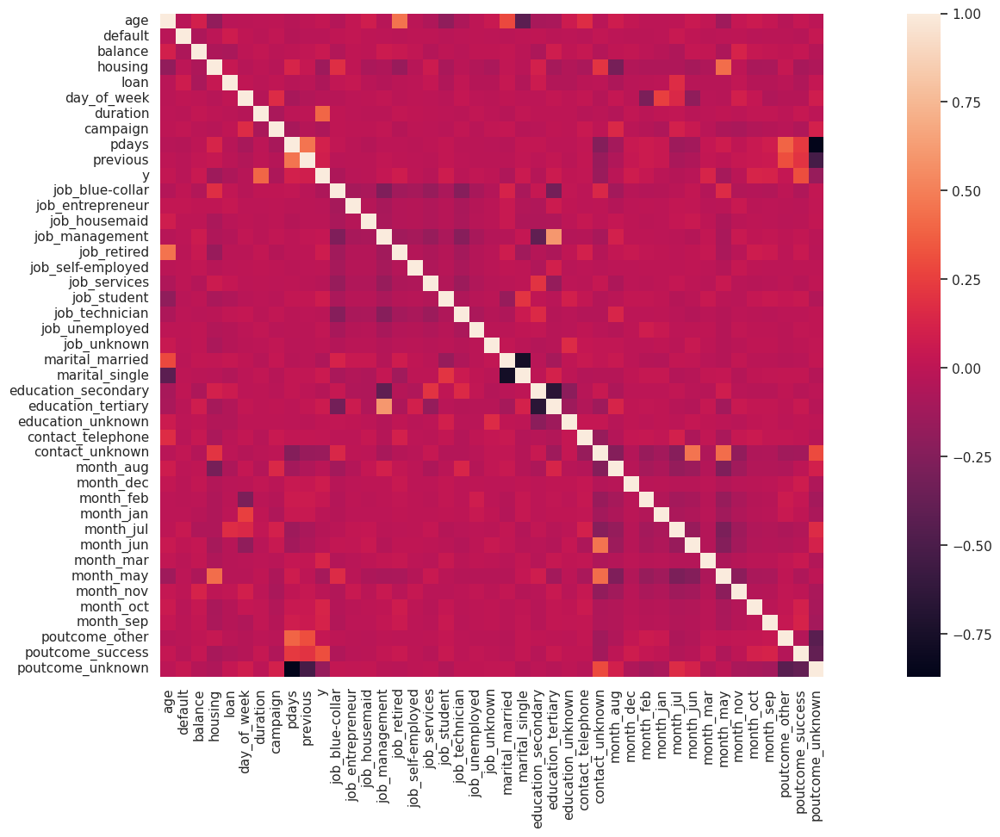

In [114]:
#Heat map
print("Correlation Matrix","\n")    
correlation=bank_dummies.corr(method="pearson")
plt.figure(figsize=(25,10))
sns.heatmap(correlation,vmax=1,square=True,annot=False)
plt.show()

In [115]:
# data set with one - hot encoding, for those algorithm which is sensitive to the catergorical variables like LogisticR...
# Choose either to use, will use 80% to do stratified cross validation, example found in Modeling section below
y_onehot = bank_dummies['y'].values
X_onehot = bank_dummies.drop(columns = ['y'])
X_train_o, X_test_o, y_train_o, y_test_o = train_test_split(X_onehot, y_onehot
                                                            , test_size=0.2
                                                            , random_state=random_state
                                                            , stratify=y_onehot
                                                           )
# check whether stratified
print(np.unique(y_train_o, return_counts=True),"\n",np.unique(y_test_o, return_counts=True))

(array([0, 1]), array([31937,  4231])) 
 (array([0, 1]), array([7985, 1058]))


In [116]:
resample_list = ['random_over_sample','SMOTE','ADASYN','BorderlineSMOTE','KMeansSMOTE', 'ClusterCentroids','random_under_sample']

def re_sample(X, y, func=None, random_state=2021):
    if func == None:
        return
    
    elif func == 'random_over_sample':
        ros = RandomOverSampler(random_state=random_state)
        X_resampled, y_resampled = ros.fit_resample(X, y)
    
    elif func == 'SMOTE':
        X_resampled, y_resampled = SMOTE().fit_resample(X, y)
    
    elif func == 'ADASYN':
        X_resampled, y_resampled = ADASYN().fit_resample(X, y)
        
    elif func == 'BorderlineSMOTE':
        X_resampled, y_resampled = BorderlineSMOTE().fit_resample(X, y)
        
    elif func == 'KMeansSMOTE':
        X_resampled, y_resampled = KMeansSMOTE(cluster_balance_threshold=0.005).fit_resample(X, y) # https://arxiv.org/pdf/1711.00837.pdf
    
    elif func == 'ClusterCentroids':
        X_resampled, y_resampled = ClusterCentroids().fit_resample(X, y)
        
    elif func == 'random_under_sample':
        X_resampled, y_resampled = RandomUnderSampler().fit_resample(X, y) 
    
    else:
        return

    return X_resampled, y_resampled

#todo: Combination of over- and under-sampling

In [117]:
from sklearn.preprocessing import LabelEncoder, OrdinalEncoder, MinMaxScaler, StandardScaler
from sklearn.feature_selection import SelectKBest, chi2, VarianceThreshold
from sklearn.model_selection import train_test_split, StratifiedKFold, KFold,GridSearchCV, cross_val_score, RandomizedSearchCV
from sklearn.metrics import confusion_matrix, auc,roc_curve,accuracy_score, f1_score, roc_auc_score, log_loss,cohen_kappa_score, classification_report, recall_score, precision_score, matthews_corrcoef,make_scorer
from sklearn.utils import resample
from sklearn.pipeline import Pipeline
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

from sklearn.naive_bayes import GaussianNB,ComplementNB, MultinomialNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier,AdaBoostClassifier, VotingClassifier, GradientBoostingClassifier, IsolationForest
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn import metrics

from imblearn.over_sampling import RandomOverSampler,SMOTE, ADASYN, BorderlineSMOTE, KMeansSMOTE
from imblearn.under_sampling import ClusterCentroids,RandomUnderSampler
from imblearn.ensemble import BalancedBaggingClassifier, BalancedRandomForestClassifier, EasyEnsembleClassifier

from sklearn.pipeline import Pipeline, make_pipeline

In [118]:
def compute_and_plot_roc_curve(model, testing_x, testing_y,name):
    predict_prob = model.predict_proba(testing_x)
    fpr, tpr, threshold = metrics.roc_curve(testing_y, predict_prob[:,1])
    roc_auc = metrics.auc(fpr, tpr)
    plt.figure(figsize=(10,10),facecolor="white")
    plt.title('Receiver Operating Characteristic')
    plt.plot(fpr, tpr, 'b', label = '{} : {:0.3f}'.format(name,roc_auc))
    plt.legend(loc = 'lower right')
    plt.plot([0, 1], [0, 1],'r--')
    plt.xlim([0, 1])
    plt.ylim([0, 1])
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    plt.show()
    
    return fpr, tpr, roc_auc

In [119]:
def model_report(model, testing_x, testing_y, name, customerized_threshold=False, threshold=0.5, plot_confusion_matrix = True) :

    predictions  = model.predict(testing_x)
    predictions_prob = model.predict_proba(testing_x)
    
    if customerized_threshold:
        predictions = []
        for pred in predictions_prob[:,1]:  
            predictions.append(1) if pred > threshold else predictions.append(0) 
    recallscore  = recall_score(testing_y,predictions)
    precision    = precision_score(testing_y,predictions)
    roc_auc      = roc_auc_score(testing_y,predictions_prob[:, 1])
    f1score      = f1_score(testing_y,predictions) 
    kappa_metric = cohen_kappa_score(testing_y,predictions)
    MCC          = matthews_corrcoef(testing_y, predictions)
    
    
    # classification_report
    print(classification_report(testing_y,predictions))
    
    # customered_confusion_matrix
    if plot_confusion_matrix:   
        fact = testing_y
        classes = list(set(fact))
        classes.sort()
        confusion = confusion_matrix(predictions, testing_y)
        plt.figure(figsize=(5,5), dpi=150)
        plt.imshow(confusion, cmap=plt.cm.Blues)
    #     plt.imshow(confusion, cmap="viridis")
        indices = range(len(confusion))
        plt.xticks(indices, classes,fontsize=10)
        plt.yticks(indices, classes,fontsize=10)
        plt.colorbar()
        plt.xlabel('Predictions',fontsize=10)
        plt.ylabel('Ground Turth',fontsize=10)
        for first_index in range(len(confusion)):
            for second_index in range(len(confusion[first_index])):
                plt.text(first_index, second_index, confusion[first_index][second_index],va = 'center',ha = 'center',c='darkorange',fontsize=10)
        plt.grid(False)
    
    df = pd.DataFrame({"Model"           : [name],
                       "Recall_score"    : [recallscore],
                       "Precision"       : [precision],
                       "f1_score"        : [f1score],
                       "Area_under_curve": [roc_auc],
                       "Kappa_metric"    : [kappa_metric],
                       "MCC"             : [MCC]
                      })
    return df

In [120]:
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=2021)

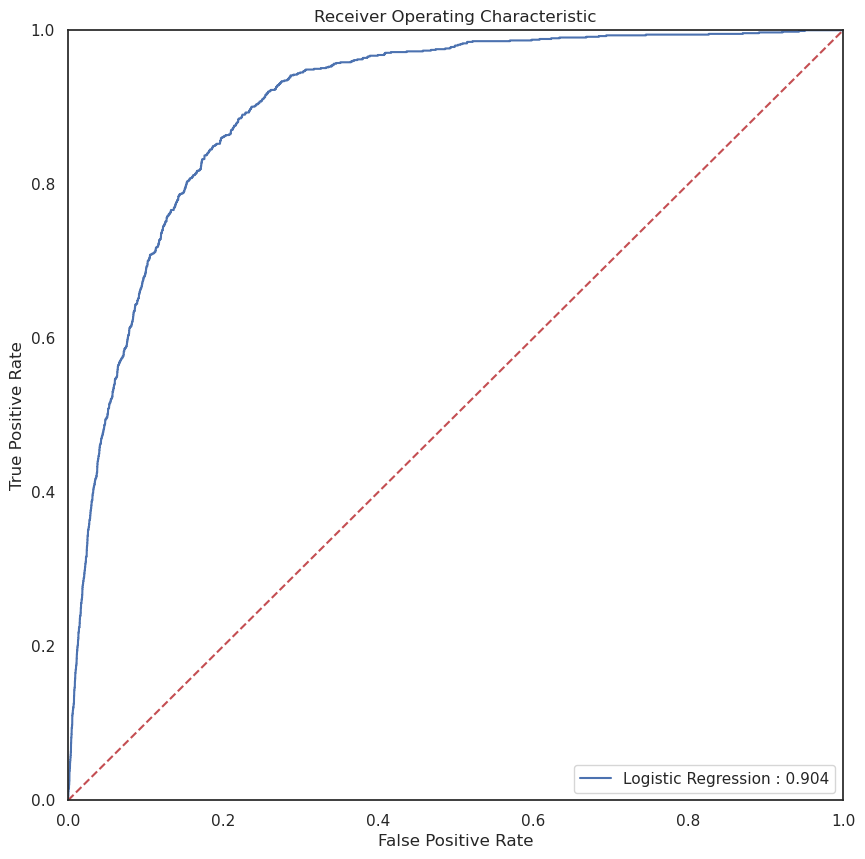

              precision    recall  f1-score   support

           0       0.97      0.84      0.90      7985
           1       0.40      0.81      0.54      1058

    accuracy                           0.84      9043
   macro avg       0.69      0.82      0.72      9043
weighted avg       0.90      0.84      0.86      9043



,Model,Recall_score,Precision,f1_score,Area_under_curve,Kappa_metric,MCC
0,Logistic Regression,0.811,0.400,0.535,0.904,0.449,0.491


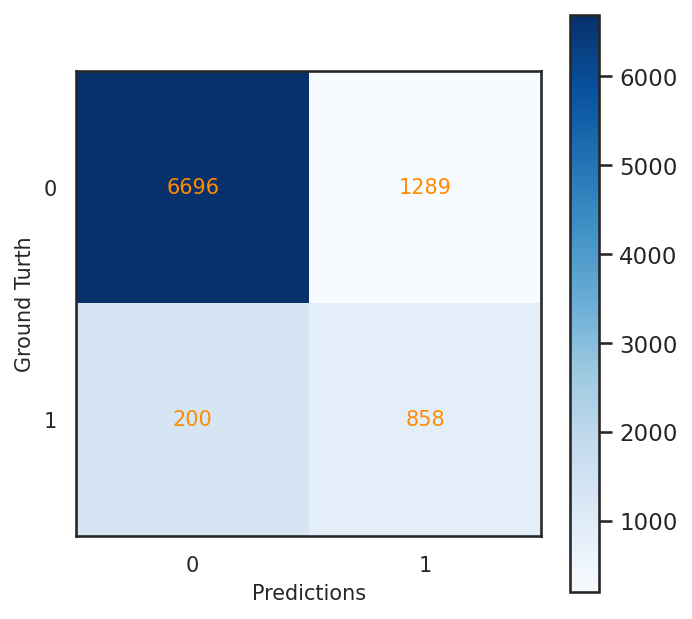

In [121]:
# Logistic Regression on the test set
RANDOM_STATE = 2023

seed = np.random.seed(RANDOM_STATE)

# Use the selected hyperparameters
lr = LogisticRegression(C = 1,
                        max_iter = 5000,
                        random_state = RANDOM_STATE)



min_max_scaler = MinMaxScaler()

# Feature selection: remove features with low variance (42 -> 40 features)
sel = VarianceThreshold(threshold=0.01)
sel_var=sel.fit_transform(X_train_o)
train_x_lv = X_train_o[X_train_o.columns[sel.get_support(indices=True)]]
test_x_lv = X_test_o[train_x_lv.columns]
#print(train_x_lv.shape)

# Feature selection: remove one of the highly correlated features > 0.8 (40 -> 39 features)
correlation_train = train_x_lv.corr(method="pearson")
columns = np.full((correlation_train.shape[0],), True, dtype=bool)
for i in range(correlation_train.shape[0]):
    for j in range(i+1, correlation_train.shape[0]):
        if abs(correlation_train.iloc[i,j]) >= 0.8:
            if columns[j]:
                columns[j] = False
selected_columns = train_x_lv.columns[columns]
train_x_cf = train_x_lv[selected_columns]
test_x_cf = test_x_lv[selected_columns]
#print(train_x_cf.shape)

# Undersampling
train_x_rs, train_y_rs = re_sample(train_x_cf, y_train_o, func='random_under_sample', random_state=RANDOM_STATE)


X_tr,  y_tr = train_x_rs, train_y_rs
X_t,  y_t = test_x_cf, y_test_o
# Train the model
lr.fit(X_tr,  y_tr)

fpr_lr, tpr_lr, auc_lr= compute_and_plot_roc_curve(lr,X_t,  y_t, "Logistic Regression")

model_lr = model_report(lr, X_t, y_t, "Logistic Regression")
model_lr

# knn

In [122]:
weights= 'distance'
n_neighbors= 9
func= 'SMOTE'

knn = KNeighborsClassifier(n_neighbors=n_neighbors, weights=weights, n_jobs=-1)

X_train_scaled = pd.DataFrame(scaler.fit_transform(X_train_o),columns=X_train_o.columns)
X_test_scaled = pd.DataFrame(scaler.transform(X_test_o),columns=X_test_o.columns)


# resample
X_train_re, y_train_re = re_sample(X_train_scaled, y_train_o, func=func)



# X_tr,  y_tr = re_sample(X_TRF, y_train, func = 'ClusterCentroids')
X_tr,  y_tr = X_train_re, y_train_re
X_t,  y_t = X_test_scaled, y_test

#train on train set
knn.fit(X_tr, y_tr)

# #predict
# predicted = knn.predict(X_t)
# predict_prob = knn.predict_proba(X_t)

fpr_knn, tpr_knn, auc_knn = compute_and_plot_roc_curve(knn, X_t, y_t, "KNN")

model_knn = model_report(knn, X_t, y_t, "KNN")
model_knn


NameError: name 'scaler' is not defined

In [123]:
def highlight_first_3_rows(row):
    if row.name < 4:
        return ['background-color: yellow'] * len(row)
    return [''] * len(row)

In [124]:
models = {
    "Decision Tree": DecisionTreeClassifier(random_state=RANDOM_STATE),
    "KNN": KNeighborsClassifier(),
    "RBF SVM": SVC(random_state=RANDOM_STATE),
    "Naive Bayes": GaussianNB(),
    "Logistic Regression": LogisticRegression(max_iter=2000, random_state=RANDOM_STATE),
}

# logistic regression

In [125]:
from scipy.stats import loguniform, randint, uniform
param_dist = {
    "logisticregression__C": loguniform(1e-3, 1e3)
}

classification_metrics = ["accuracy", "precision", "recall", "f1", "roc_auc"]

pipe = make_pipeline(
    MinMaxScaler(),
    models['Logistic Regression']  
    )

random_search = RandomizedSearchCV(pipe, 
                                   param_dist, 
                                   n_iter=100, 
                                   n_jobs=-1, 
                                   cv=5,
                                   scoring=classification_metrics,
                                   refit='roc_auc',
                                   return_train_score=True,
                                   random_state=RANDOM_STATE
                                  )

In [126]:
random_search.fit(X_tr, y_tr)

RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('minmaxscaler', MinMaxScaler()),
                                             ('logisticregression',
                                              LogisticRegression(max_iter=2000,
                                                                 random_state=2023))]),
                   n_iter=100, n_jobs=-1,
                   param_distributions={'logisticregression__C': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x7fed7814f3a0>},
                   random_state=2023, refit='roc_auc', return_train_score=True,
                   scoring=['accuracy', 'precision', 'recall', 'f1', 'roc_auc'])

In [127]:
random_search.best_params_

{'logisticregression__C': 72.78297811052217}

In [128]:
random_search.best_score_

0.9108263391896463

In [ ]:
# Logistic Regression on the test set

# Use the selected hyperparameters
best_C = random_search.best_params_['logisticregression__C']

lr = LogisticRegression(C=best_C,
                        random_state=RANDOM_STATE)

# Undersampling
train_x_rs, train_y_rs = re_sample(train_x_cf, y_train_o, func='random_under_sample', random_state=RANDOM_STATE)


X_tr,  y_tr = train_x_rs, train_y_rs
X_t,  y_t = test_x_cf, y_test_o
# Train the model
lr.fit(X_tr,  y_tr)

fpr_lr, tpr_lr, auc_lr= compute_and_plot_roc_curve(lr,X_t,  y_t, "Logistic Regression")

model_lr = model_report(lr, X_t, y_t, "Logistic Regression")
model_lr

# knn

In [130]:
from scipy.stats import loguniform, randint, uniform
param_dist = {
    "kneighborsclassifier__n_neighbors": range(10,50),
    "kneighborsclassifier__weights":['uniform', 'distance']
}

classification_metrics = ["accuracy", "precision", "recall", "f1", "roc_auc"]

pipe = make_pipeline(
    MinMaxScaler(),
    models['KNN']  
    )

random_search = GridSearchCV(pipe, 
                             param_dist, 
                             n_jobs=-1, 
                             cv=5,
                             scoring=classification_metrics,
                             refit='roc_auc',
                             return_train_score=True
                            )

In [131]:
random_search.fit(X_tr, y_tr)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('minmaxscaler', MinMaxScaler()),
                                       ('kneighborsclassifier',
                                        KNeighborsClassifier())]),
             n_jobs=-1,
             param_grid={'kneighborsclassifier__n_neighbors': range(10, 50),
                         'kneighborsclassifier__weights': ['uniform',
                                                           'distance']},
             refit='roc_auc', return_train_score=True,
             scoring=['accuracy', 'precision', 'recall', 'f1', 'roc_auc'])

In [132]:
random_search.best_params_

{'kneighborsclassifier__n_neighbors': 39,
 'kneighborsclassifier__weights': 'distance'}

In [133]:
random_search.best_score_

0.8057500414888237

# Decision Tree 

In [134]:
param_dist = {
    "decisiontreeclassifier__max_depth": range(2, 100),
    "decisiontreeclassifier__criterion": ['gini', 'entropy', 'log_loss']
}

classification_metrics = ["accuracy", "precision", "recall", "f1", "roc_auc"]

pipe = make_pipeline(
    MinMaxScaler(),
    models['Decision Tree']  
    )

random_search = RandomizedSearchCV(pipe, 
                                   param_dist, 
                                   n_iter=100, 
                                   n_jobs=-1, 
                                   cv=5,
                                   scoring=classification_metrics,
                                   refit='roc_auc',
                                   return_train_score=True,
                                   random_state=RANDOM_STATE
                                  )

In [135]:
random_search.fit(X_tr, y_tr)

RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('minmaxscaler', MinMaxScaler()),
                                             ('decisiontreeclassifier',
                                              DecisionTreeClassifier(random_state=2023))]),
                   n_iter=100, n_jobs=-1,
                   param_distributions={'decisiontreeclassifier__criterion': ['gini',
                                                                              'entropy',
                                                                              'log_loss'],
                                        'decisiontreeclassifier__max_depth': range(2, 100)},
                   random_state=2023, refit='roc_auc', return_train_score=True,
                   scoring=['accuracy', 'precision', 'recall', 'f1', 'roc_auc'])

In [136]:
random_search.best_params_

{'decisiontreeclassifier__max_depth': 7,
 'decisiontreeclassifier__criterion': 'entropy'}

In [137]:
random_search.best_score_

0.879356936661764

# Naive Bayes

In [138]:
param_dist = {
    "gaussiannb__var_smoothing": uniform(0, 1),
}

classification_metrics = ["accuracy", "precision", "recall", "f1", "roc_auc"]

pipe = make_pipeline(
    MinMaxScaler(),
    models['Naive Bayes']  
    )

random_search = RandomizedSearchCV(pipe, 
                                   param_dist, 
                                   n_iter=100, 
                                   n_jobs=-1, 
                                   cv=5,
                                   scoring=classification_metrics,
                                   refit='roc_auc',
                                   return_train_score=True,
                                   random_state=RANDOM_STATE
                                  )

In [139]:
random_search.fit(X_tr, y_tr)

RandomizedSearchCV(cv=5,
                   estimator=Pipeline(steps=[('minmaxscaler', MinMaxScaler()),
                                             ('gaussiannb', GaussianNB())]),
                   n_iter=100, n_jobs=-1,
                   param_distributions={'gaussiannb__var_smoothing': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x7fee58d56710>},
                   random_state=2023, refit='roc_auc', return_train_score=True,
                   scoring=['accuracy', 'precision', 'recall', 'f1', 'roc_auc'])

In [140]:
random_search.best_params_

{'gaussiannb__var_smoothing': 0.013205631128021644}

In [141]:
random_search.best_score_

0.7963575973487218